In [1]:
import sys
import os
import cv2
import os
import pandas as pd
import numpy as np
import datetime
from PIL import Image, ImageDraw,ImageFont
import face_recognition as fr
import dlib


In [2]:
face_ds_path = r"./faces"
known_face_encodings=[]
known_face_names=[]

In [3]:
img = fr.load_image_file(os.path.join(face_ds_path,"@sankalp.jpg"))
img_encoding = fr.face_encodings(img)[0] #will store this in data base along with the images
known_face_encodings.append(img_encoding)
known_face_names.append("@Sankalp")
print(len(known_face_encodings))

1


Detected faces:  0
face_locations [[11, 578, 52, 537], [454, 1926, 642, 1738], [592, 847, 845, 594], [781, 576, 1194, 163], [50, 622, 153, 519], [628, 2194, 846, 1976], [1175, 1005, 1232, 948]]
face_encodings: [array([-0.02645958,  0.07268939,  0.12851521, -0.09163318, -0.1201612 ,
        0.0130121 , -0.09460148, -0.0803162 ,  0.15733457, -0.07611122,
        0.0829744 ,  0.04623896, -0.21219511,  0.06776893, -0.03195411,
        0.0682509 , -0.13541152, -0.11035199, -0.11924528, -0.07402036,
       -0.06554697,  0.1294966 ,  0.05330445,  0.02894369, -0.10986623,
       -0.26030773, -0.08487622, -0.06104808,  0.01599347, -0.10402444,
        0.03310921,  0.00882815, -0.23814519, -0.02840861,  0.03054466,
        0.0669093 , -0.06276337, -0.06628086,  0.16031079,  0.03695478,
       -0.18010721, -0.0702128 ,  0.04276973,  0.22355004,  0.20345873,
        0.02316847, -0.009158  , -0.06684364,  0.12537371, -0.29836267,
        0.10599903,  0.13496171,  0.05064053,  0.11959563,  0.0694959

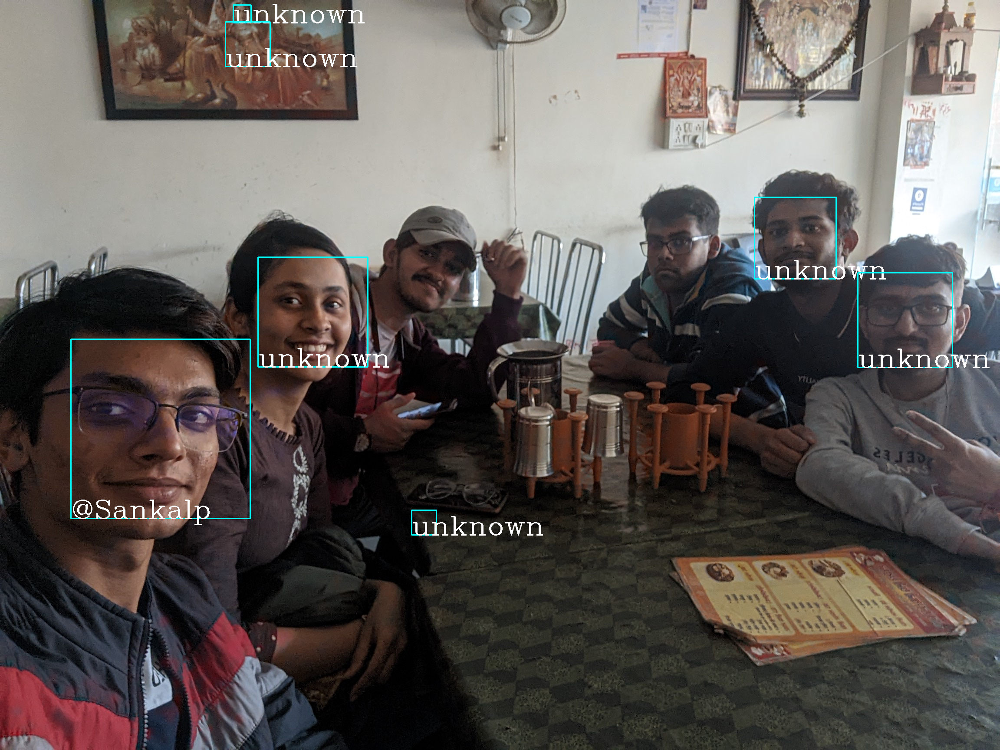

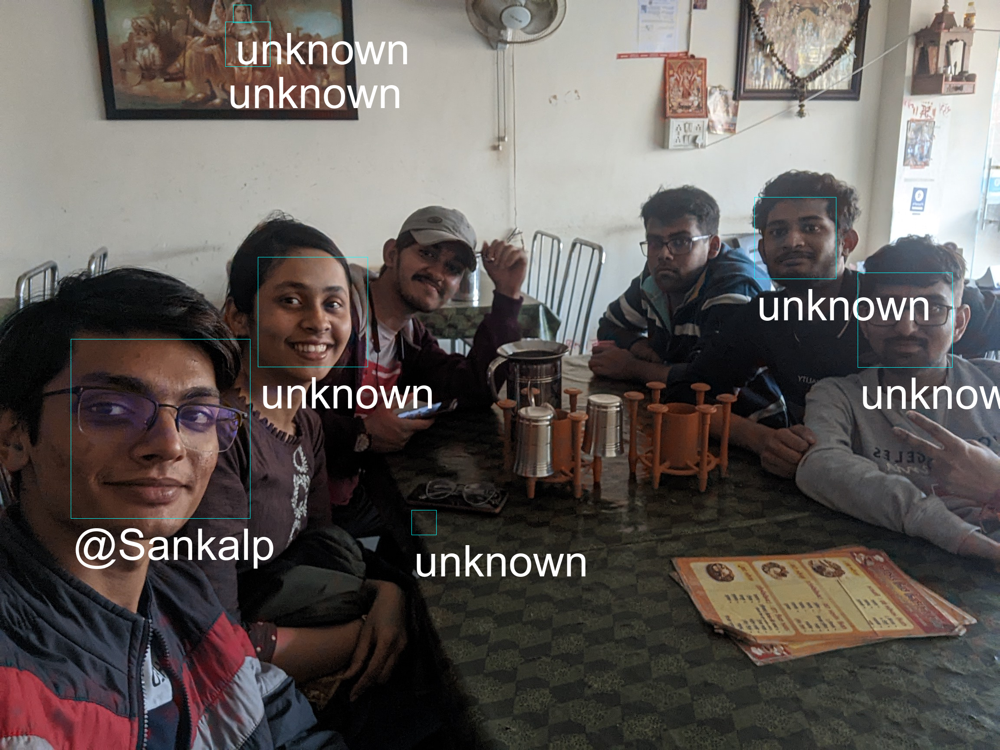

In [4]:
# Load an image with an unknown face
unknown_image = fr.load_image_file("./group_photos/2.jpg")
# Using classifier to detect face instead of using fr.face_location
face_classifier=cv2.CascadeClassifier(r"./cv2_classifiers/haarcascade_frontalface_default.xml")

# Find all the faces and face encodings in the unknown image
# face_locations = fr.face_locations(unknown_image,number_of_times_to_upsample=1)
# print("Detected faces: ",len(face_locations))
# print("face_locations", face_locations)
face_locations=[]
faces = face_classifier.detectMultiScale(unknown_image,1.1,5) # output (x, y, w, h)
print("Detected faces: ",len(face_locations))
for (x,y,w,h) in faces:
    # print(x,y,w,h)
    top = y
    right = x + w
    bottom = y + h
    left = x
    face_locations.append([top, right, bottom, left])

# print("faces", faces)
print("face_locations",face_locations)
face_encodings = fr.face_encodings(unknown_image, face_locations)
print("face_encodings:",face_encodings)
im = unknown_image.copy()
pil_image = Image.fromarray(unknown_image)
draw=ImageDraw.Draw(pil_image)
for (x, y, w, h), (top, right, bottom, left), face_encoding in zip(faces,face_locations, face_encodings):
    # top = y
    # right = x + w
    # bottom = y + h 
    # left = x
    # cv2.rectangle(im, (top, left), (right, bottom), (225, 0, 0), 2)
    matches = fr.compare_faces(known_face_encodings, face_encoding) # input required format = (top, right, bottom, left)
    print("matches", matches)
    name="unknown"
    face_distances = fr.face_distance(known_face_encodings, face_encoding)
    print("face_distances", face_distances)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = known_face_names[best_match_index]
    print(name)
    cv2.rectangle(im, (x, y), (x + w, y + h), (0, 255, 255), 2)
    cv2.putText(im,name,(x, y+h), cv2.FONT_HERSHEY_COMPLEX,2,(255,255,255),2)
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 255, 255))
    draw.text((left + 6, bottom + 5), name, fill=(255, 255, 255, 255),font=ImageFont.truetype("arial.ttf",100))
    
    # Draw a label with a name below the face
    # text_width, text_height = draw.textlength(name)
    # text_height=draw.textlength(name)
    # print(text_height)
    
    # draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    # draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))




del(draw)

display(Image.fromarray(im))
display(pil_image)

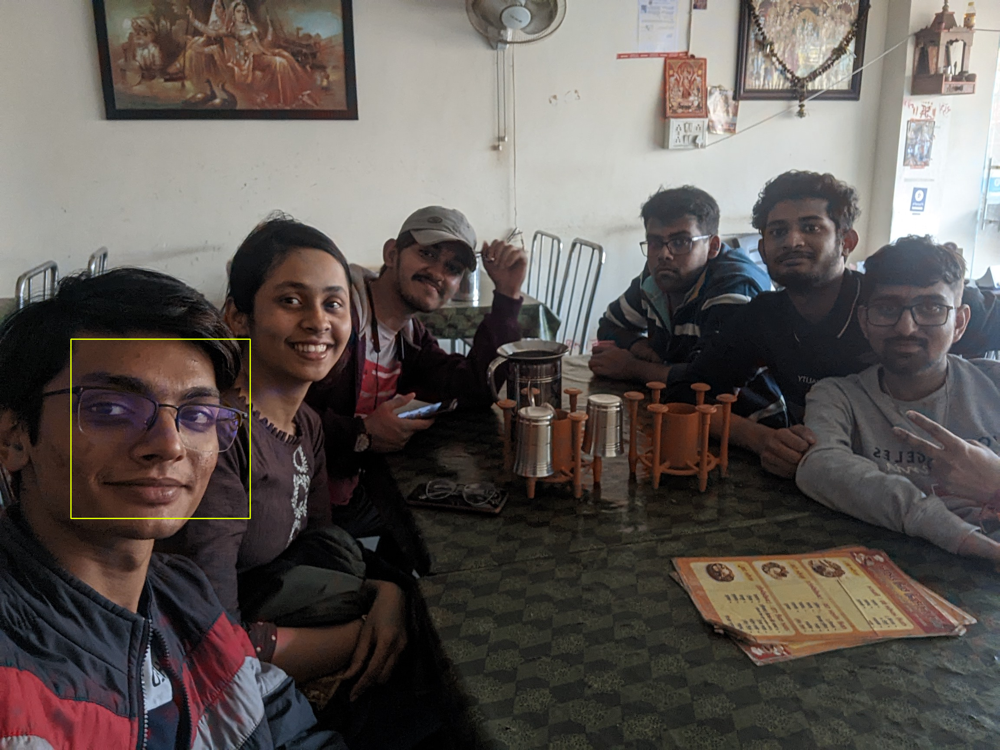

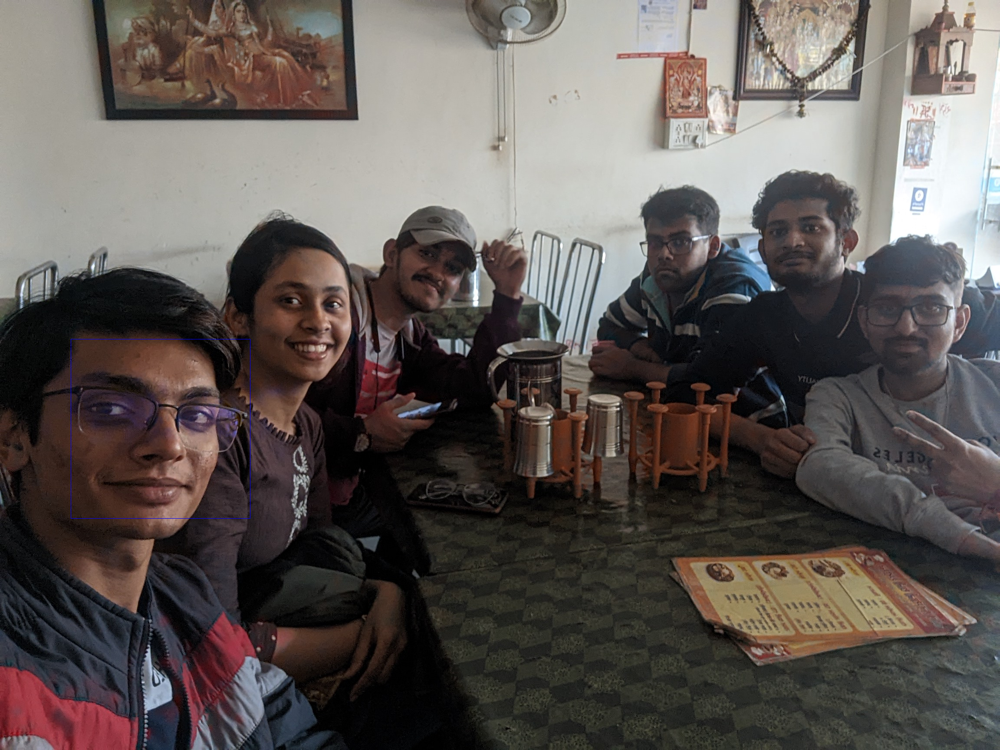

In [29]:
x,y,w,h=[ 163,781,413,413]
im = unknown_image.copy()
cv2.rectangle(im, (x, y), (x + w, y + h), (225, 255, 0), 2)
display(Image.fromarray(im))

top, right, bottom, left = [781, 576, 1194, 163]

pil_image = Image.fromarray(unknown_image)
draw = ImageDraw.Draw(pil_image)

draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))


del(draw)
display(pil_image)

In [24]:
fd = dlib.get_frontal_face_detector()
detected_faces_dlib = fd(unknown_image,3)



In [23]:
print(len(detected_faces_dlib))
print(detected_faces_dlib)

5
rectangles[[(609, 636) (840, 867)], [(1742, 477) (1902, 637)], [(167, 833) (566, 1233)], [(1984, 658) (2176, 850)], [(540, 15) (571, 46)]]


In [12]:
# detecting face using haarcascade
unknown_image = fr.load_image_file("./group_photos/2.jpg")


In [28]:
s = face_encoding.tobytes()
s

b'\x00\x00\x00 *\xe4\xb7\xbf\x00\x00\x00`\xdd\xb1\xba?\x00\x00\x00@\x1a\xb6\xb5?\x00\x00\x00@\xf2r\xa4\xbf\x00\x00\x00\x80@c\xbc\xbf\x00\x00\x00`M\x00\xb3\xbf\x00\x00\x00\xc0F\xd5w\xbf\x00\x00\x00@\xdd\xf4\x85\xbf\x00\x00\x00\xa0\x18\xd1\xbe?\x00\x00\x00\xc0\x8a\xdd\x98\xbf\x00\x00\x00\xe0Q\xd1\xca?\x00\x00\x00\xc0\x1b\x16~\xbf\x00\x00\x00\xc0\xd2\xef\xcd\xbf\x00\x00\x00`\xf7\xaa\xab\xbf\x00\x00\x00\xc0\x17\xe4\x8a?\x00\x00\x00\xa0=\xae\xb9?\x00\x00\x00 \x02\x82\xb3\xbf\x00\x00\x00`\xe3\x12\xb1\xbf\x00\x00\x00`\x02\xbf\xb9\xbf\x00\x00\x00`\x8a\xe0\xbc\xbf\x00\x00\x00 \xb1S\x8a?\x00\x00\x00\xe0\xf0S\xb3?\x00\x00\x00\xe0\x1d\x86\x96?\x00\x00\x00\xc0\xca\xbc\xa4?\x00\x00\x00\x00W\x90\x9d\xbf\x00\x00\x00\xa0\xc4:\xd0\xbf\x00\x00\x00\xe0\x99\xa1\xb2\xbf\x00\x00\x00\xc00C\xb3\xbf\x00\x00\x00`\x02"\xb7?\x00\x00\x00\xe0}h\xc0\xbf\x00\x00\x00\xa0,\xd2\x8c?\x00\x00\x00\xc0\x92\x01\xa6?\x00\x00\x00\xe0\x9dz\xc3\xbf\x00\x00\x00\x00\xffA\xb1\xbf\x00\x00\x00 \xd9\x12\x99?\x00\x00\x00`\xac\xbf\xb5?\x

In [29]:
fe = np.frombuffer(s)

In [5]:
output=[{'name': '@nidhi', 'distance': 0.4366160345766236, 'bbox': (1215, 624, 270, 270)}, {'name': '@sankalp', 'distance': 0.5797563719218032, 'bbox': (1535, 537, 249, 249)}, {'name': '@sankalp', 'distance': 0.5258878715822006, 'bbox': (196, 728, 518, 518)}]
name="@nidhi"

In [7]:
existing_entry = next((dic for dic in output if dic["name"] == name), None)
if existing_entry:
    existing_entry["distance"]=0
else:
    print("new")
print(output)

[{'name': '@nidhi', 'distance': 0, 'bbox': (1215, 624, 270, 270)}, {'name': '@sankalp', 'distance': 0.5797563719218032, 'bbox': (1535, 537, 249, 249)}, {'name': '@sankalp', 'distance': 0.5258878715822006, 'bbox': (196, 728, 518, 518)}]


['./faces/1.jpg']


AttributeError: 'str' object has no attribute 'trip'